In [1]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
import tensorflow as tf
import cv2
import os
from sklearn.model_selection import train_test_split
from src import *

In [2]:
import pathlib


if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone --depth 1 https://github.com/tensorflow/models

In [3]:
%%bash
cd models/research/
/Users/scotthines/protoc-3.15.6-osx-x86_64/bin/protoc object_detection/protos/*.proto --python_out=.

In [4]:
import numpy as np
import six.moves.urllib as urllib
import sys
import tarfile
import zipfile

from collections import defaultdict
from io import StringIO
from IPython.display import display

from models.research.object_detection.utils import ops as utils_ops
from models.research.object_detection.utils import label_map_util
from models.research.object_detection.utils import visualization_utils as vis_util

In [5]:
%matplotlib inline

In [6]:
image_file_loc = 'Hey-Waldo/64'
classification = ['waldo', 'notwaldo']

### Model Loader Function from TensorFlow

In [7]:
def load_model(model_name):
  base_url = 'http://download.tensorflow.org/models/object_detection/'
  model_file = model_name + '.tar.gz'
  model_dir = tf.keras.utils.get_file(
    fname=model_name, 
    origin=base_url + model_file,
    untar=True)

  model_dir = pathlib.Path(model_dir)/"saved_model"

  model = tf.saved_model.load(str(model_dir))

  return model

In [8]:
# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = 'models/research/object_detection/data/mscoco_label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

In [9]:
model_name = 'ssd_mobilenet_v1_coco_2017_11_17'
detection_model = load_model(model_name)

def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis,...]

  # Run inference
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy() 
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  # detection_classes should be ints.
  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
   
  # Handle models with masks:
  if 'detection_masks' in output_dict:
    # Reframe the the bbox mask to the image size.
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])      
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()
    
  return output_dict

INFO:tensorflow:Saver not created because there are no variables in the graph to restore


In [10]:
def show_inference(model, image_path):
  # the array based representation of the image will be used later in order to prepare the
  # result image with boxes and labels on it.
  image_np = np.array(Image.open(image_path))
  # Actual detection.
  output_dict = run_inference_for_single_image(model, image_np)
  # Visualization of the results of a detection.
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)

  display(Image.fromarray(image_np))

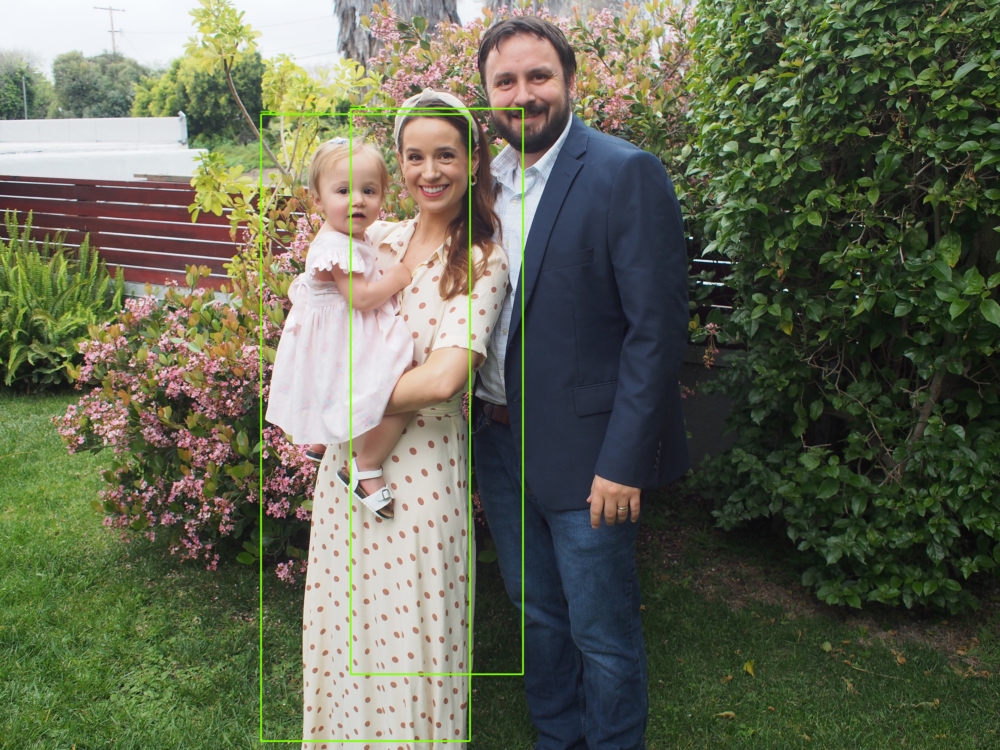

In [11]:
path_to_image = 'IMG_2728.jpg'
show_inference(detection_model, path_to_image)

### Some steps happened external to the notebook here:

- I used the package labelimg to assign a location for Waldo within all of my training images. 
- I split the training images and their respective xml files that are created with the labelimg package into train and test folders. 
- I used some helper code from datitran (https://github.com/datitran/raccoon_dataset/blob/master/xml_to_csv.py) to convert my xml files to csv files. 

### Taking a look at the datasets of waldo locations within the train and test split

In [14]:
train_data = pd.read_csv('data/train_labels.csv')
test_data = pd.read_csv('data/test_labels.csv')

In [15]:
train_data.head()

,filename,width,height,class,xmin,ymin,xmax,ymax
0,waldo86.jpg,1700,2340,waldo,1565,1029,1625,1123
1,waldo92.jpg,1984,1226,waldo,413,67,486,159
2,waldo92.jpg,1984,1226,waldo,169,949,190,995
3,waldo93.jpg,128,128,waldo,76,30,94,58
4,waldo87.jpg,1600,1006,waldo,293,427,315,478


In [16]:
test_data.head()

,filename,width,height,class,xmin,ymin,xmax,ymax
0,waldo51.jpg,64,64,waldo,41,25,64,64
1,waldo52.jpg,1298,951,waldo,229,732,265,778
2,waldo53.jpg,256,256,waldo,230,30,256,83
3,waldo108.jpg,1590,981,waldo,1256,74,1291,122
4,waldo109.jpg,256,256,waldo,1,179,20,223
